Background & Context

The Thera bank recently saw a steep decline in the number of users of their credit card, credit cards are a good source of income for banks because of different kinds of fees charged by the banks like annual fees, balance transfer fees, and cash advance fees, late payment fees, foreign transaction fees, and others. Some fees are charged to every user irrespective of usage, while others are charged under specified circumstances.

Customers’ leaving credit cards services would lead bank to loss, so the bank wants to analyze the data of customers and identify the customers who will leave their credit card services and reason for same – so that bank could improve upon those areas

You as a Data scientist at Thera bank need to come up with a classification model that will help the bank improve its services so that customers do not renounce their credit cards

You need to identify the best possible model that will give the required performance






Objective

        1. Explore and visualize the dataset.
        2. Build a classification model to predict if the customer is going to churn or not
        3.Optimize the model using appropriate techniques
        4. Generate a set of insights and recommendations that will help the bank
        
        
Data Dictionary:
       1.  CLIENTNUM: Client number. Unique identifier for the customer holding the account
       2.   Attrition_Flag: Internal event (customer activity) variable - if the account is closed then "Attrited Customer" else "Existing Customer"
       3. Customer_Age: Age in Years
       4. Gender: Gender of the account holder
       5. Dependent_count: Number of dependents
       
       6. Education_Level:  Educational Qualification of the account holder - Graduate, High School, Unknown, Uneducated, College(refers to a college student), Post-Graduate, Doctorate.
       
       7. Marital_Status: Marital Status of the account holder
       
       8. Income_Category: Annual Income Category of the account holder
       
       9. Card_Category: Type of Card
       
       10. Months_on_book: Period of relationship with the bank
       
       11. Total_Relationship_Count: Total no. of products held by the customer
       
       12. Months_Inactive_12_mon: No. of months inactive in the last 12 months
       
       13. Contacts_Count_12_mon: No. of Contacts between the customer and bank in the last 12 months
       
       14. Credit_Limit: Credit Limit on the Credit Card
       
       15. Total_Revolving_Bal: The balance that carries over from one month to the next is the revolving balance
       
       16. Avg_Open_To_Buy: Open to Buy refers to the amount left on the credit card to use (Average of last 12 months)
       
       17. Total_Trans_Amt: Total Transaction Amount (Last 12 months)
       
       18. Total_Trans_Ct: Total Transaction Count (Last 12 months)
       
       19. Total_Ct_Chng_Q4_Q1: Ratio of the total transaction count in 4th quarter and the total transaction count in 1st quarter
       
       20. Total_Amt_Chng_Q4_Q1: Ratio of the total transaction amount in 4th quarter and the total transaction amount in 1st quarter
       
       21. Avg_Utilization_Ratio: Represents how much of the available credit the customer spent
       

       
      
       
 

### Importing Libraries

In [1]:
# To help with reading and manipulating data
import pandas as pd
import numpy as np

# To help with data visualization
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

# To be used for missing value imputation
from sklearn.impute import SimpleImputer

# To help with model building
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import (
    AdaBoostClassifier,
    GradientBoostingClassifier,
    RandomForestClassifier,
    BaggingClassifier,
)
from xgboost import XGBClassifier

# To get different metric scores, and split data
from sklearn import metrics
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.metrics import (
    f1_score,
    accuracy_score,
    recall_score,
    precision_score,
    confusion_matrix,
    roc_auc_score,
    plot_confusion_matrix,
)

# To be used for data scaling and one hot encoding
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder

# To be used for tuning the model
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

# To be used for creating pipelines and personalizing them
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

# To define maximum number of columns to be displayed in a dataframe
pd.set_option("display.max_columns", None)

# To supress scientific notations for a dataframe
pd.set_option("display.float_format", lambda x: "%.3f" % x)

# To supress warnings
import warnings

warnings.filterwarnings("ignore")



# To impute missing values
from sklearn.impute import KNNImputer

# To build a logistic regression model
from sklearn.linear_model import LogisticRegression

# To oversample and undersample data
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

# To suppress the warnings
import warnings

warnings.filterwarnings("ignore")



### Loading Data

In [2]:
data = pd.read_csv("BankChurners.csv")

In [3]:
# Checking the number of rows and columns in the data
data.shape

(10127, 21)

* The dataset has 10127 rows and 21 columns 

## Data Overview

In [4]:
# let's create a copy of the data, so you can proceed with the currnet one
dc = data.copy()

In [5]:
# let's view the first 5 rows of the data
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.000,777,11914.000,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.000,864,7392.000,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.000,0,3418.000,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,NaN,Less than $40K,Blue,34,3,4,1,3313.000,2517,796.000,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.000,0,4716.000,2.175,816,28,2.500,0.000


In [6]:
# let's view the last 5 rows of the data
data.tail()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.000,1851,2152.000,0.703,15476,117,0.857,0.462
10123,710638233,Attrited Customer,41,M,2,NaN,Divorced,$40K - $60K,Blue,25,4,2,3,4277.000,2186,2091.000,0.804,8764,69,0.683,0.511
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.000,0,5409.000,0.819,10291,60,0.818,0.000
10125,717406983,Attrited Customer,30,M,2,Graduate,NaN,$40K - $60K,Blue,36,4,3,3,5281.000,0,5281.000,0.535,8395,62,0.722,0.000
10126,714337233,Attrited Customer,43,F,2,Graduate,Married,Less than $40K,Silver,25,6,2,4,10388.000,1961,8427.000,0.703,10294,61,0.649,0.189


In [7]:
# let's check the data types of the columns in the dataset
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  object 
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           8608 non-null   object 
 6   Marital_Status            9378 non-null   object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     10127 non-null  int64  
 13  Credit_Limit              10127 non-null  float64
 14  Total_

# Checking for duplicates in the csv

In [8]:
# let's check for duplicate values in the data
data.duplicated().sum()

0

In [9]:
# let's check for missing values in the data
round(data.isnull().sum() / data.isnull().count() * 100, 2)

CLIENTNUM                   0.000
Attrition_Flag              0.000
Customer_Age                0.000
Gender                      0.000
Dependent_count             0.000
Education_Level            15.000
Marital_Status              7.400
Income_Category             0.000
Card_Category               0.000
Months_on_book              0.000
Total_Relationship_Count    0.000
Months_Inactive_12_mon      0.000
Contacts_Count_12_mon       0.000
Credit_Limit                0.000
Total_Revolving_Bal         0.000
Avg_Open_To_Buy             0.000
Total_Amt_Chng_Q4_Q1        0.000
Total_Trans_Amt             0.000
Total_Trans_Ct              0.000
Total_Ct_Chng_Q4_Q1         0.000
Avg_Utilization_Ratio       0.000
dtype: float64

       . Here are the columsns we need to work on for missing Data Education_Level   15.000   Marital_Status 7.400

In [10]:
# let's view the statistical summary of the numerical columns in the data
data.describe().T

,count,mean,std,min,25%,50%,75%,max
CLIENTNUM,10127.000,739177606.334,36903783.450,708082083.000,713036770.500,717926358.000,773143533.000,828343083.000
Customer_Age,10127.000,46.326,8.017,26.000,41.000,46.000,52.000,73.000
Dependent_count,10127.000,2.346,1.299,0.000,1.000,2.000,3.000,5.000
Months_on_book,10127.000,35.928,7.986,13.000,31.000,36.000,40.000,56.000
Total_Relationship_Count,10127.000,3.813,1.554,1.000,3.000,4.000,5.000,6.000
Months_Inactive_12_mon,10127.000,2.341,1.011,0.000,2.000,2.000,3.000,6.000
Contacts_Count_12_mon,10127.000,2.455,1.106,0.000,2.000,2.000,3.000,6.000
Credit_Limit,10127.000,8631.954,9088.777,1438.300,2555.000,4549.000,11067.500,34516.000
Total_Revolving_Bal,10127.000,1162.814,814.987,0.000,359.000,1276.000,1784.000,2517.000
Avg_Open_To_Buy,10127.000,7469.140,9090.685,3.000,1324.500,3474.000,9859.000,34516.000


**Observations:**
- `Customer_Age` has a large range of values i.e. 26 to 73. 
- `Credit_Limit` has a large range of values i.e. 1438.300 to 34516.000. 
-  `CLIENTNUM`   does not help in any value addition to analysis, we can drop it before using for analysis.

- Credit_Limit has a max value of 34516.000 which is far greater than the mean  8631.954 and could be an outlier.


## Data Preprocessing

- We can drop the column - `CLIENTNUM` as it is unique for each customer and will not add value to the model.

In [11]:
# Dropping column - CLIENTNUM
data.drop(columns=["CLIENTNUM"], inplace=True)

In [12]:
print(data["Marital_Status"].isnull())

0        False
1        False
2        False
3         True
4        False
         ...  
10122    False
10123    False
10124    False
10125     True
10126    False
Name: Marital_Status, Length: 10127, dtype: bool


In [13]:
print(data["Education_Level"].unique())

['High School' 'Graduate' 'Uneducated' nan 'College' 'Post-Graduate'
 'Doctorate']


In [14]:
dataTypeSeries = data.dtypes

In [15]:
from pandas_profiling import ProfileReport
ProfileReport(data)

Summarize dataset:   0%|          | 0/33 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Observations 

### Variables  Category 5 Numeric 15
    
-  `Attrition_Flag`  : has 2 data pointers 1, 0 of which 10 percent are leaving the credit card
-  'Customer_Age' :  has high correlation with 2 other columns, Months on the book and Dependent Count
-  'Gender' : We have 5358  Female and 4769  Male 
-  'Marital_Status': has high correlation with card category
-   'Income Cateogry' has high correlation on card category, which is understood
-   'Card Category' : there are 4 diferent cards and they are not evenly distributed among users.
-   'Months On the Book' : This shows that users are with the account from atleast one year to almost 5 years
-   'Months in active' : can be very interesting as, it also means users are using other cards and can eventually stop using this
-   'Credit Limit' : This also shows how much user expected to spend and what can be potential income source. it also has outliars. 

- 'Total Transaction Amount' : This show the potential users speiding to generate infome to the bank.  With minimum 510 to max 18484
- 'Total Transaction Count' : This shows how frequently users use credit card. 
-  'Average Utlization Ratio' : This show the usage of card on average and helps us to determine users speding habbits  

### Get value counts on our category columns 

In [16]:
# Printing number of count of each unique value in each column
for column in data:
    if data[column].dtype == np.object:
        print(data[column].value_counts())

Existing Customer    8500
Attrited Customer    1627
Name: Attrition_Flag, dtype: int64
F    5358
M    4769
Name: Gender, dtype: int64
Graduate         3128
High School      2013
Uneducated       1487
College          1013
Post-Graduate     516
Doctorate         451
Name: Education_Level, dtype: int64
Married     4687
Single      3943
Divorced     748
Name: Marital_Status, dtype: int64
Less than $40K    3561
$40K - $60K       1790
$80K - $120K      1535
$60K - $80K       1402
abc               1112
$120K +            727
Name: Income_Category, dtype: int64
Blue        9436
Silver       555
Gold         116
Platinum      20
Name: Card_Category, dtype: int64


**Observations:**
- `Card_Category` has a large customer base for Blue but Platinums are less. 
- `Income_Category` has a large range of values i.e. less than $40K : 3561 and Less than  <80k but > 40k are also similar.
-  `Education`   there are large number of people with Graduate degreethe mean  8631.954 and could be an outlier.


-  `Card_Category`   there are large number of people with Graduate degreethe mean  8631.954 and could be an outlier.



In [17]:
print(data.Dependent_count.value_counts())


data[data.Marital_Status.isnull()].Dependent_count

# data[Marital_Status] = data.apply(lambda x: 'Married' if x[Dependent_count]>0 else x[Marital_Status], axis=1)




3    2732
2    2655
1    1838
4    1574
0     904
5     424
Name: Dependent_count, dtype: int64


3        4
7        0
10       5
13       3
15       4
        ..
10070    3
10100    2
10101    2
10118    1
10125    2
Name: Dependent_count, Length: 749, dtype: int64

### hee we now change cateogry values to numerical ones so we can massage the data for encoding 

In [18]:
for y in data.columns:
    if data[y].dtype == np.object:
        print("column:", y)
        print(data[y].unique())
        print("-------------")

column: Attrition_Flag
['Existing Customer' 'Attrited Customer']
-------------
column: Gender
['M' 'F']
-------------
column: Education_Level
['High School' 'Graduate' 'Uneducated' nan 'College' 'Post-Graduate'
 'Doctorate']
-------------
column: Marital_Status
['Married' 'Single' nan 'Divorced']
-------------
column: Income_Category
['$60K - $80K' 'Less than $40K' '$80K - $120K' '$40K - $60K' '$120K +'
 'abc']
-------------
column: Card_Category
['Blue' 'Gold' 'Silver' 'Platinum']
-------------


## EDA

### Univariate

In [19]:
# function to plot a boxplot and a histogram along the same scale.


def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to the show density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="violet"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins, palette="winter"
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="black", linestyle="-"
    )  # Add median to the histogram

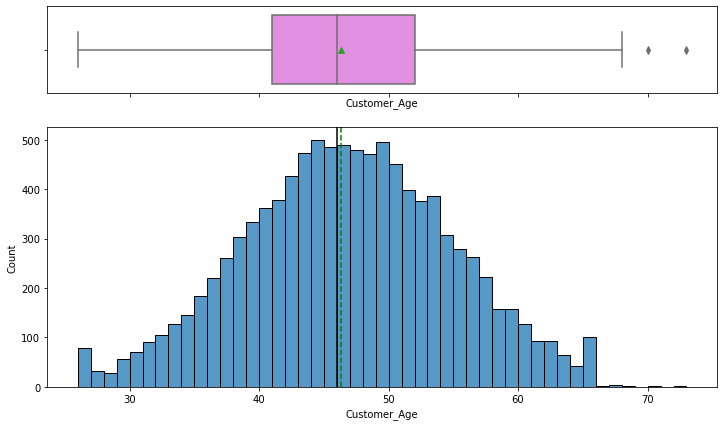

In [20]:
# Observations on Customer_age
histogram_boxplot(data, "Customer_Age")

- As per the boxplot, there are no outliers in the 'Customer_Age' variable
- Age has a fairly normal distribution with approx equal mean and median

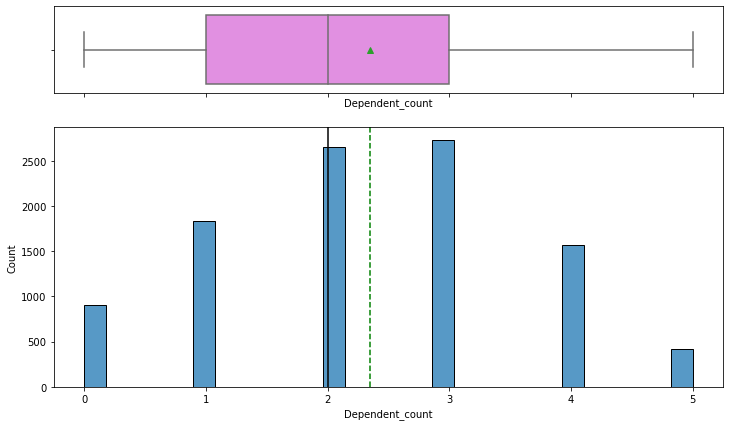

In [21]:
# observations on Income
histogram_boxplot(data, "Dependent_count")

- As per the boxplot, there are no outliers in the 'Dependent_count' variable
- Dependent_count has a fairly normal distribution with approx equal mean and median

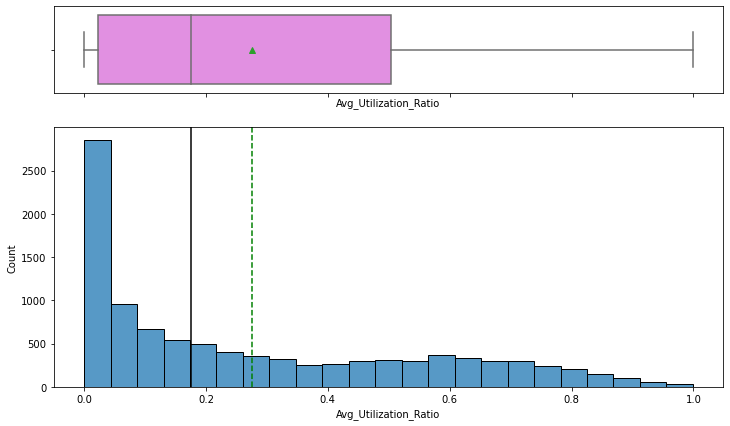

In [22]:
# observations on Income
histogram_boxplot(data, "Avg_Utilization_Ratio")

- The 'Avg_Utilization_Ratio' variable is not evenly distributed as its not equally distributed.
- The 'Avg_Utilization_Ratio' variable is highly skewed to the right.
- There are some outliers on the right end of the boxplot but we will not treat them as some variation is always expected in real-world scenarios for variables like Avg_Utilization_Ratio spent.


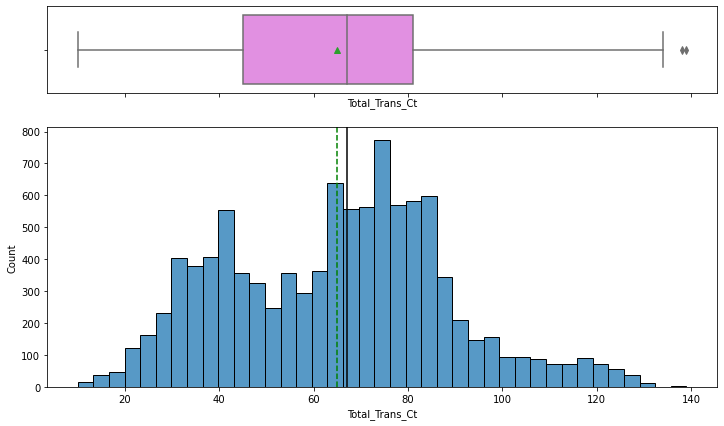

In [23]:
# observations on Income
histogram_boxplot(data, "Total_Trans_Ct")

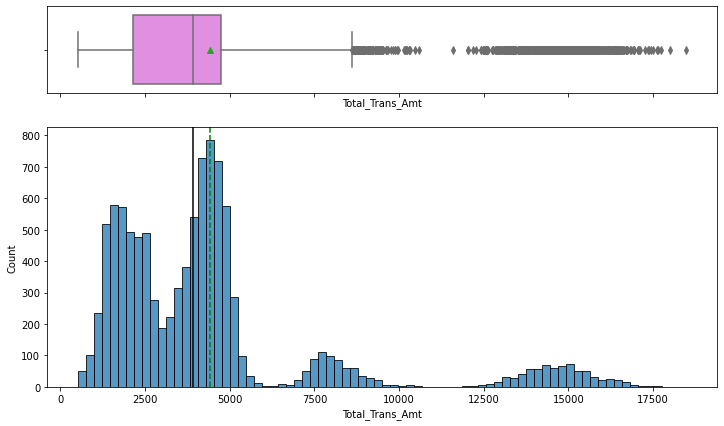

In [24]:
# observations on Income
histogram_boxplot(data, "Total_Trans_Amt")

- The 'Total_Trans_Amt' variable is not evenly distributed as its not equally distributed.


In [25]:
# Checking 10 largest values of amount spend on meat products
data.Total_Trans_Amt.nlargest(10)

9964     18484
10073    17995
10097    17744
9601     17634
9341     17628
10117    17498
10028    17437
9643     17390
9712     17350
9645     17258
Name: Total_Trans_Amt, dtype: int64

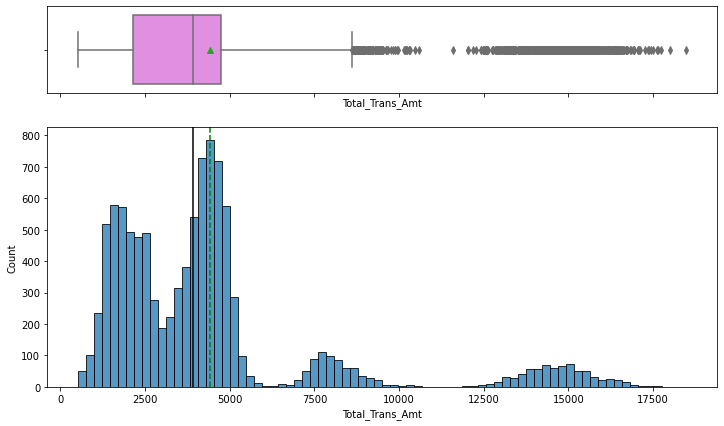

In [26]:
# observations on MntFishProducts
histogram_boxplot(data, "Total_Trans_Amt")

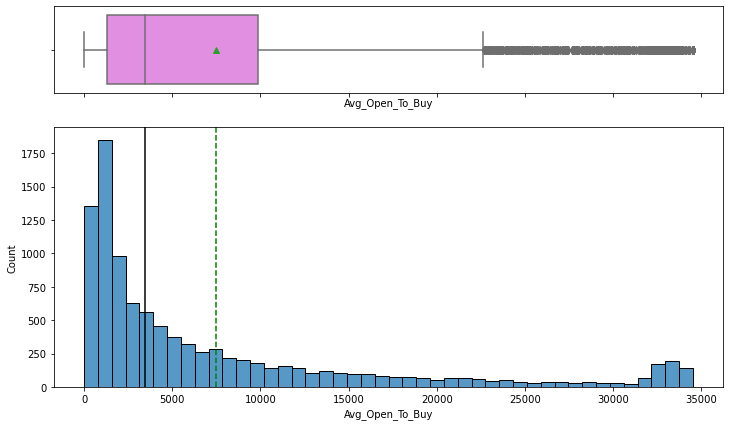

In [27]:
# observations on MntFishProducts
histogram_boxplot(data, "Avg_Open_To_Buy")

In [28]:
# function to create labeled barplots


def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of count (default is False)
    n: displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # length of the column
    count = data[feature].nunique()
    if n is None:
        plt.figure(figsize=(count + 1, 5))
    else:
        plt.figure(figsize=(n + 1, 5))

    plt.xticks(rotation=90, fontsize=15)
    ax = sns.countplot(
        data=data,
        x=feature,
        palette="pastel",
        order=data[feature].value_counts().index[:n].sort_values(),
    )
    sns.set_style("whitegrid")

    for p in ax.patches:
        if perc == True:
            label = "{:.1f}%".format(
                100 * p.get_height() / total
            )  # percentage of each class of the category
        else:
            label = p.get_height()  # count of each level of the category

        x = p.get_x() + p.get_width() / 2  # width of the plot
        y = p.get_height()  # height of the plot

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )  # annotate the percentage

    plt.show()  # show the plot

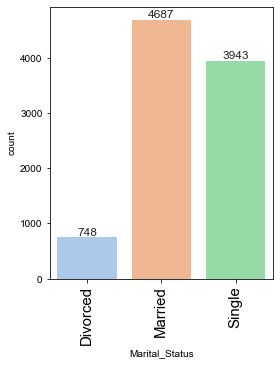

In [29]:
# observations on Marital_Status
labeled_barplot(data, "Marital_Status")

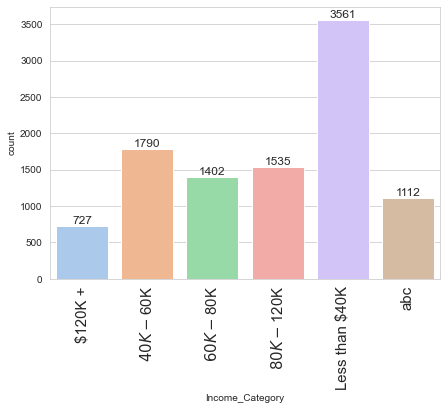

In [30]:
# observations on Kidhome
labeled_barplot(data, "Income_Category")

        . The customer base is concenrtraed more on the lower end. with majority under 80k

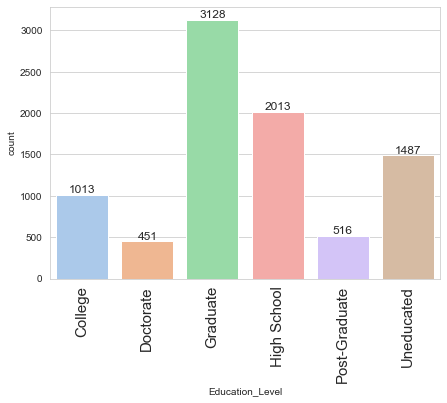

In [31]:
# observations on Kidhome
labeled_barplot(data, "Education_Level")

         . Graduatesa  are most ferquest or more often to take or open credit card and spend on it

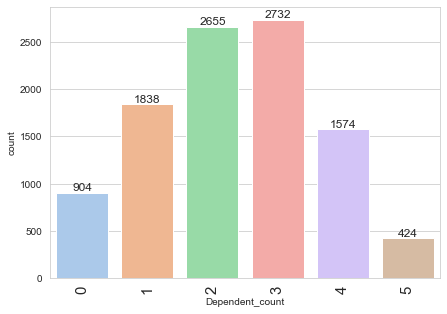

In [32]:
# observations on Kidhome
labeled_barplot(data, "Dependent_count")

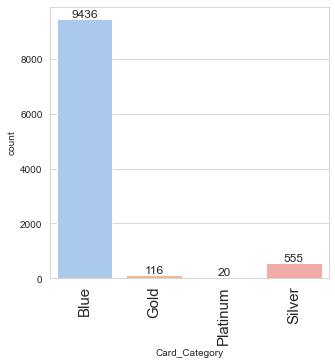

In [33]:
# observations on Kidhome
labeled_barplot(data, "Card_Category")

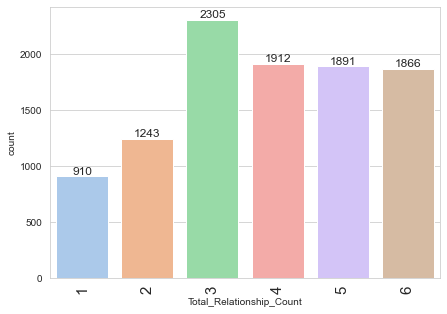

In [34]:
# observations on Kidhome
labeled_barplot(data, "Total_Relationship_Count")

     . Most customers has more than 3 products from the bank

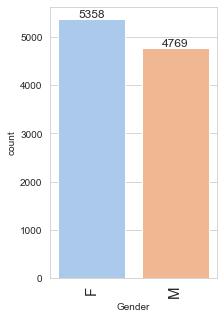

In [35]:
# observations on Kidhome
labeled_barplot(data, "Gender")

      . we have more female customers than male as seen while working on the csv

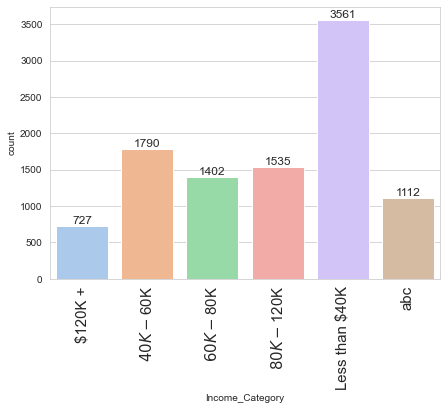

In [36]:
# observations on Kidhome
labeled_barplot(data, "Income_Category")

### Bivariate Analysis

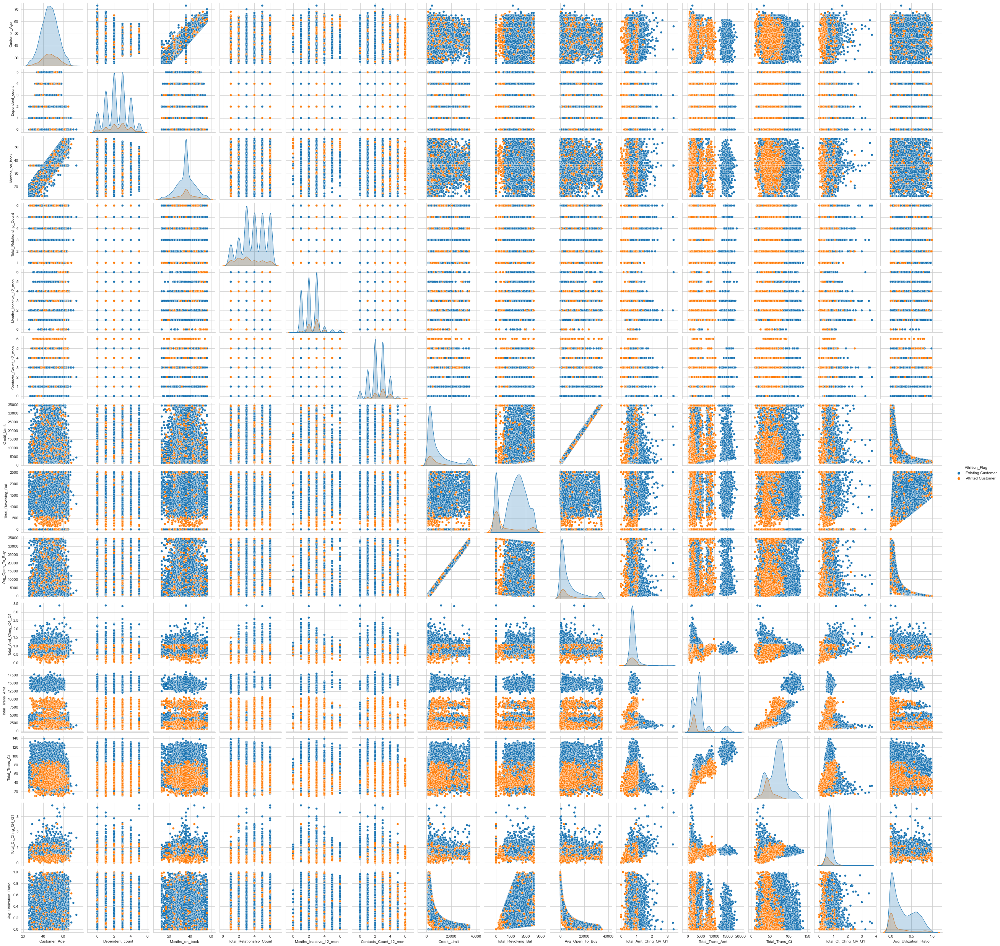

In [37]:
sns.pairplot(data, hue="Attrition_Flag")

<AxesSubplot:xlabel='Education_Level', ylabel='Total_Trans_Amt'>

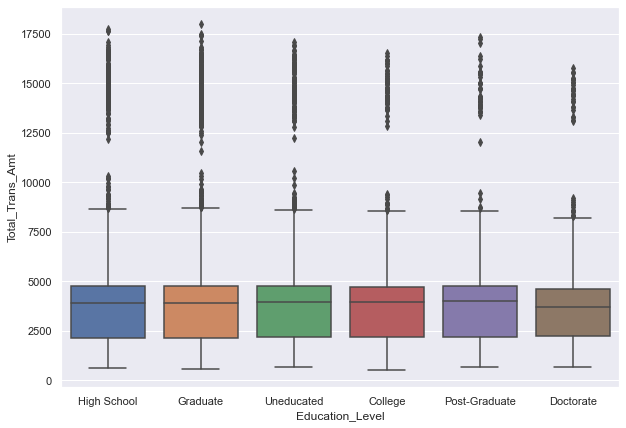

In [38]:
sns.set(rc={"figure.figsize": (10, 7)})
sns.boxplot(y="Total_Trans_Amt", x="Education_Level", data=data, orient="vertical")

<AxesSubplot:xlabel='Education_Level', ylabel='Total_Trans_Ct'>

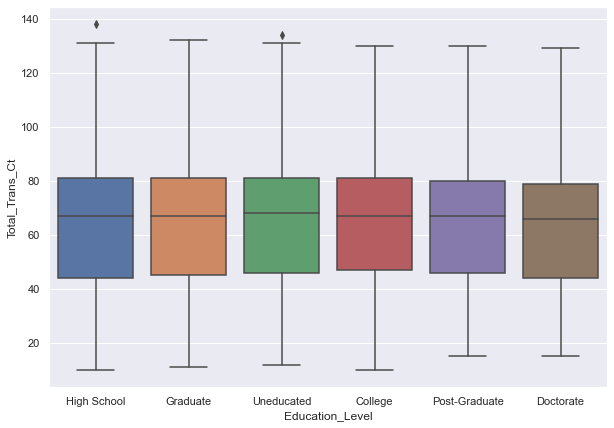

In [39]:
sns.boxplot(y="Total_Trans_Ct", x="Education_Level", data=data, orient="vertical")

<AxesSubplot:xlabel='Total_Trans_Ct'>

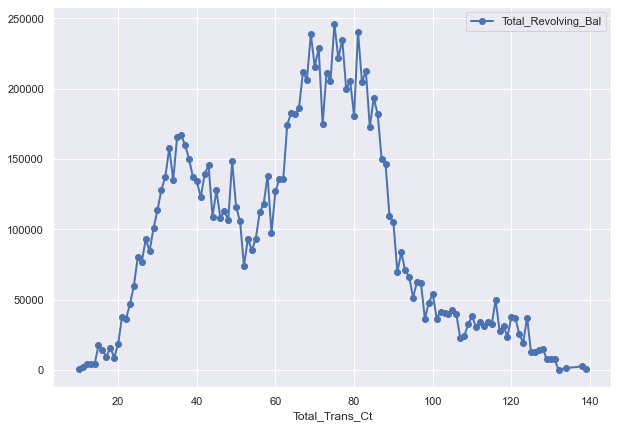

In [40]:
pd.pivot_table(
    data=data,
    index=["Total_Trans_Ct"],
    values="Total_Revolving_Bal",
    aggfunc=np.sum,
).plot(kind="line", marker="o", linewidth=2)

<AxesSubplot:xlabel='Income_Category'>

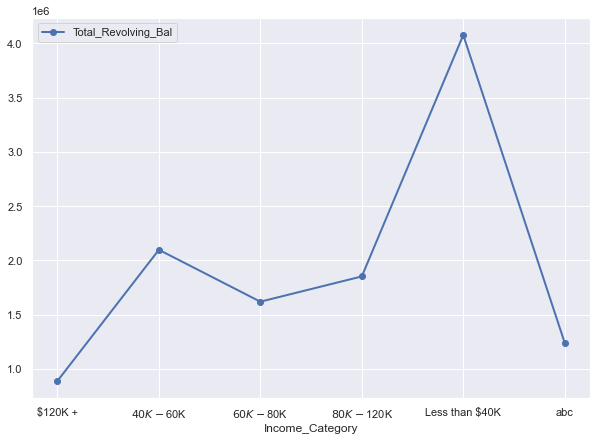

In [41]:
pd.pivot_table(
    data=data,
    index=["Income_Category"],
    values="Total_Revolving_Bal",
    aggfunc=np.sum,
).plot(kind="line", marker="o", linewidth=2)

<AxesSubplot:xlabel='Total_Relationship_Count', ylabel='Months_on_book'>

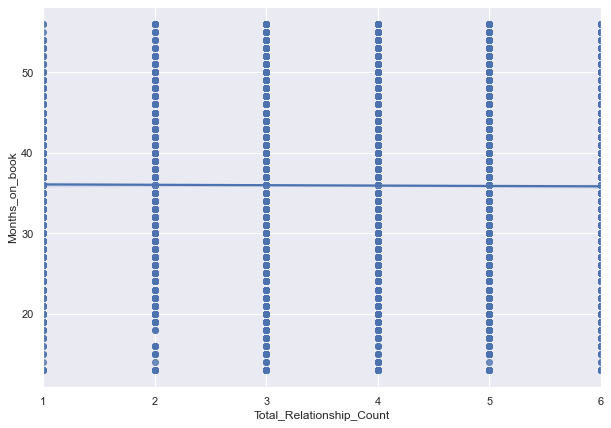

In [42]:
sns.regplot(y=data.Months_on_book, x=data.Total_Relationship_Count)

<AxesSubplot:xlabel='Card_Category', ylabel='Credit_Limit'>

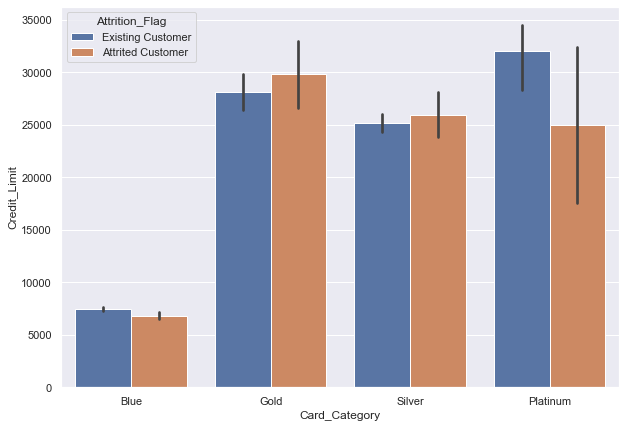

In [43]:
sns.barplot(data= data,  x = "Card_Category",y="Credit_Limit", hue = "Attrition_Flag")


<AxesSubplot:xlabel='Marital_Status', ylabel='Credit_Limit'>

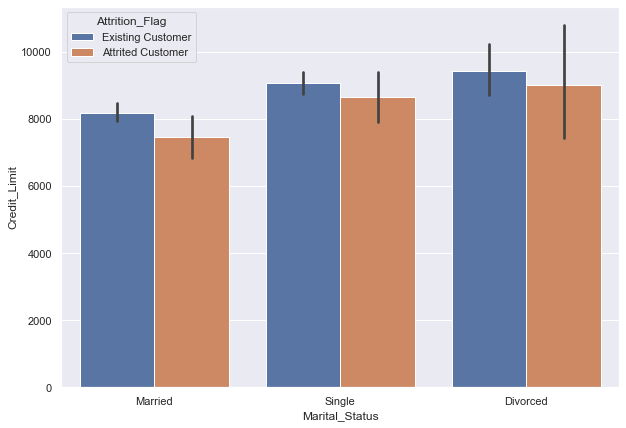

In [44]:
sns.barplot(data= data,  x = "Marital_Status",y="Credit_Limit", hue = "Attrition_Flag")


<AxesSubplot:xlabel='Total_Relationship_Count', ylabel='Total_Trans_Amt'>

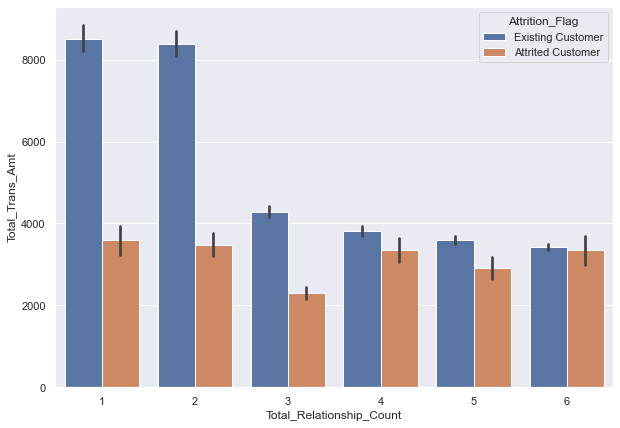

In [45]:
sns.barplot(data= data,  x = "Total_Relationship_Count",y="Total_Trans_Amt" , hue = "Attrition_Flag")


   . Customers who tend to close the account do spend less on the credit cardd  it is a huge idicator 

<AxesSubplot:xlabel='Months_Inactive_12_mon', ylabel='Attrition_Flag'>

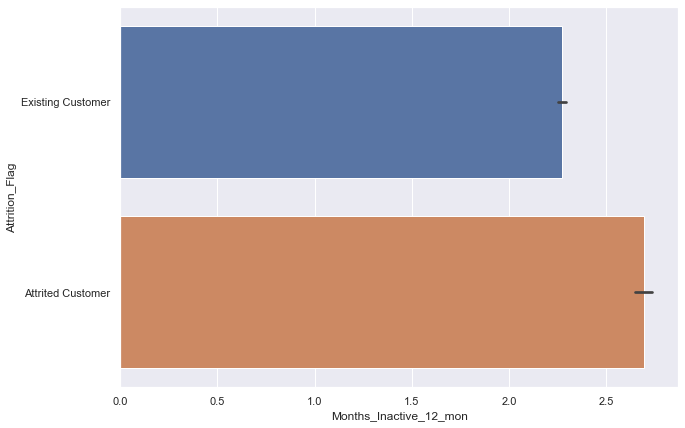

In [46]:
sns.barplot(data= data,  x = "Months_Inactive_12_mon", y = "Attrition_Flag")

<AxesSubplot:xlabel='Card_Category', ylabel='Months_Inactive_12_mon'>

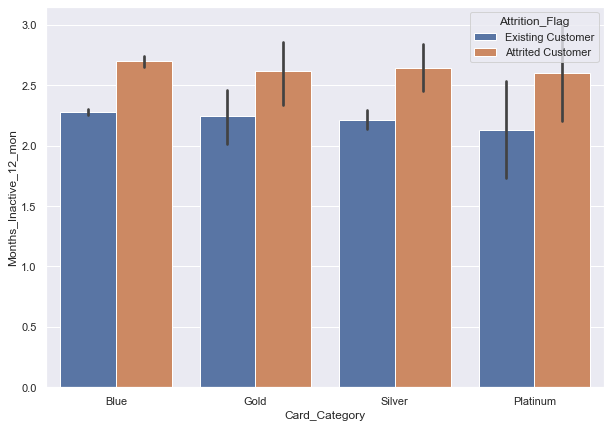

In [47]:
sns.barplot(data= data,  x = "Card_Category", y = "Months_Inactive_12_mon", hue = "Attrition_Flag")

     . Increae in a 12 month of inactive months, also clearly show that customers can laeve the product

. The in activity does not resemble of leaving the account in this graph 

### Observations

    . Attrition is almost equal to half in above observation, However they are all under 100k income 

<AxesSubplot:xlabel='Avg_Utilization_Ratio', ylabel='Credit_Limit'>

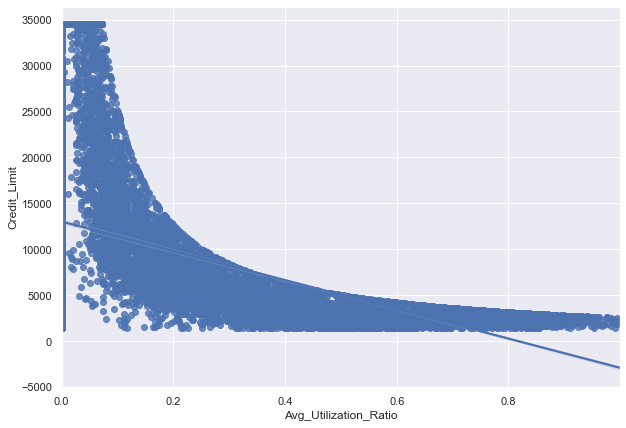

In [48]:
sns.regplot(y=data.Credit_Limit, x=data.Avg_Utilization_Ratio)

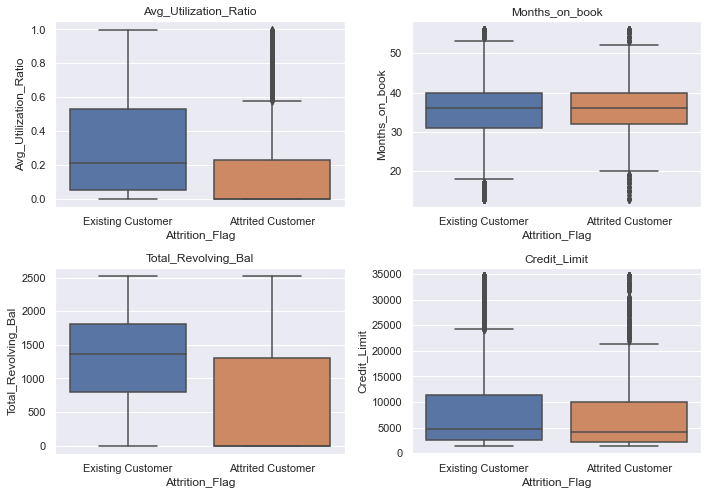

In [49]:
cols = data[
    ["Avg_Utilization_Ratio", "Months_on_book", "Total_Revolving_Bal", "Credit_Limit"]
].columns.tolist()
plt.figure(figsize=(10, 10))

for i, variable in enumerate(cols):
    plt.subplot(3, 2, i + 1)
    sns.boxplot(data["Attrition_Flag"], data[variable])
    plt.tight_layout()
    plt.title(variable)
plt.show()

In [50]:
# function to plot stacked bar chart


def stacked_barplot(data, predictor, target):
    """
    Print the category counts and plot a stacked bar chart

    data: dataframe
    predictor: independent variable
    target: target variable
    """
    count = data[predictor].nunique()
    sorter = data[target].value_counts().index[-1]
    tab1 = pd.crosstab(data[predictor], data[target], margins=True).sort_values(
        by=sorter, ascending=False
    )
    print(tab1)
    print("-" * 120)
    tab = pd.crosstab(data[predictor], data[target], normalize="index").sort_values(
        by=sorter, ascending=False
    )
    tab.plot(kind="bar", stacked=True, figsize=(count + 1, 5))
    plt.legend(
        loc="lower left", frameon=False,
    )
    plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
    plt.show()

In [51]:
#stacked_barplot(data, "Marital_Status", "Education_Level")

In [52]:
#stacked_barplot(data, "Marital_Status", "Card_Category")

In [53]:
#stacked_barplot(data, "Card_Category", "Marital_Status")

In [54]:
#stacked_barplot(data, "Total_Trans_Ct", "Avg_Utilization_Ratio")

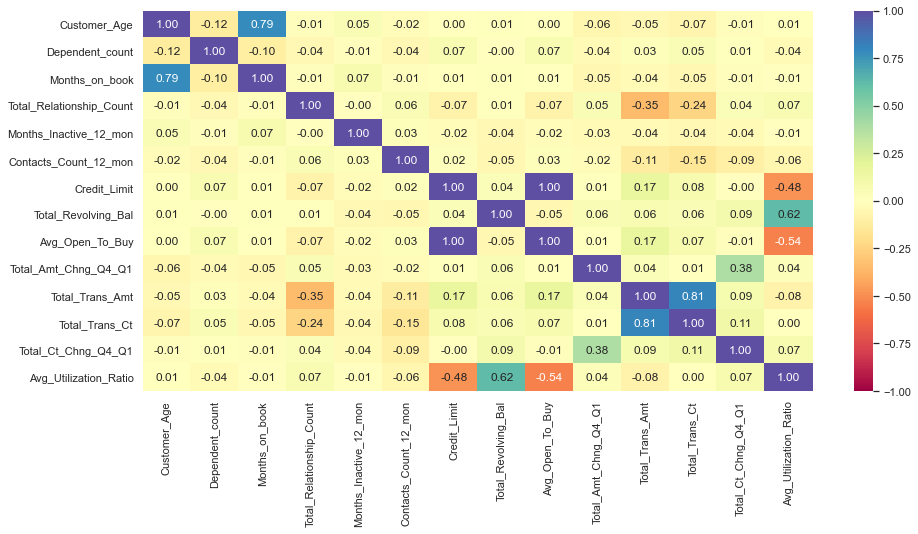

In [55]:
plt.figure(figsize=(15, 7))
sns.heatmap(data.corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="Spectral")
plt.show()

### Data Preparation for Modeling

## Feature Engineering

### Missing-Value Treatment

* We will use KNN imputer to impute missing values.
* `KNNImputer`: Each sample's missing values are imputed by looking at the n_neighbors nearest neighbors found in the training set. Default value for n_neighbors=5.
* KNN imputer replaces missing values using the average of k nearest non-missing feature values.
* Nearest points are found based on euclidean distance.


**The values obtained might not be integer always which is not be the best way to impute categorical values**
- To take care of that we will round off the obtained values to nearest integer value

In [56]:
data.isnull().sum()

Attrition_Flag                 0
Customer_Age                   0
Gender                         0
Dependent_count                0
Education_Level             1519
Marital_Status               749
Income_Category                0
Card_Category                  0
Months_on_book                 0
Total_Relationship_Count       0
Months_Inactive_12_mon         0
Contacts_Count_12_mon          0
Credit_Limit                   0
Total_Revolving_Bal            0
Avg_Open_To_Buy                0
Total_Amt_Chng_Q4_Q1           0
Total_Trans_Amt                0
Total_Trans_Ct                 0
Total_Ct_Chng_Q4_Q1            0
Avg_Utilization_Ratio          0
dtype: int64

In [57]:
imputer = KNNImputer(n_neighbors=5)

In [58]:
# defining a list with names of columns that will be used for imputation
reqd_col_for_impute = ["Marital_Status", "Education_Level", "Income_Category"]

In [59]:
data[reqd_col_for_impute].head()

,Marital_Status,Education_Level,Income_Category
0,Married,High School,$60K - $80K
1,Single,Graduate,Less than $40K
2,Married,Graduate,$80K - $120K
3,NaN,High School,Less than $40K
4,Married,Uneducated,$60K - $80K


In [60]:
# we need to pass numerical values for each categorical column for KNN imputation so we will label encode them

Education_Level= {"High School":0, "Graduate":1, "Uneducated":2, "College":3, "Post-Graduate":4,
"Doctorate":5}

data["Education_Level"] = data["Education_Level"].map(Education_Level)


Marital_Status ={"Married":0, "Single":1, "Divorced":2}
data["Marital_Status"] = data["Marital_Status"].map(Marital_Status)

Attrition_Flag = {"Existing Customer":0, "Attrited Customer":1}

data["Attrition_Flag"] = data["Attrition_Flag"].map(Attrition_Flag)

Income_Category ={"$60K - $80K":0, "Less than $40K":1, "$80K - $120K":2, "$40K - $60K":3, "$120K +":4}
data["Income_Category"] = data["Income_Category"].map(Income_Category)

Card_Category ={"Blue":0, "Gold":1, "Silver":2, "Platinum":3}
data["Card_Category"] = data["Card_Category"].map(Card_Category)

   


In [61]:
data.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,0,45,M,3,0.000,0.000,0.000,0,39,5,1,3,12691.000,777,11914.000,1.335,1144,42,1.625,0.061
1,0,49,F,5,1.000,1.000,1.000,0,44,6,1,2,8256.000,864,7392.000,1.541,1291,33,3.714,0.105
2,0,51,M,3,1.000,0.000,2.000,0,36,4,1,0,3418.000,0,3418.000,2.594,1887,20,2.333,0.000
3,0,40,F,4,0.000,NaN,1.000,0,34,3,4,1,3313.000,2517,796.000,1.405,1171,20,2.333,0.760
4,0,40,M,3,2.000,0.000,0.000,0,21,5,1,0,4716.000,0,4716.000,2.175,816,28,2.500,0.000


* Values have been encoded.

### Data Preparation for Modeling

In [62]:
X = data.drop(["Attrition_Flag"], axis=1)
y = data["Attrition_Flag"]

In [63]:
# Splitting data into training, validation and test set:
# first we split data into 2 parts, say temporary and test

X_temp, X_test, y_temp, y_test = train_test_split(
    X, y, test_size=0.2, random_state=1, stratify=y
)

# then we split the temporary set into train and validation

X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, test_size=0.25, random_state=1, stratify=y_temp
)
print(X_train.shape, X_val.shape, X_test.shape)

(6075, 19) (2026, 19) (2026, 19)


In [64]:
print("Number of rows in train data =", X_train.shape[0])
print("Number of rows in validation data =", X_val.shape[0])
print("Number of rows in test data =", X_test.shape[0])

Number of rows in train data = 6075
Number of rows in validation data = 2026
Number of rows in test data = 2026


**Imputing Missing Values**

In [65]:
# Fit and transform the train data
X_train[reqd_col_for_impute] = imputer.fit_transform(X_train[reqd_col_for_impute])

# Transform the train data
X_val[reqd_col_for_impute] = imputer.transform(X_val[reqd_col_for_impute])

# Transform the test data
X_test[reqd_col_for_impute] = imputer.transform(X_test[reqd_col_for_impute])

In [66]:
# Checking that no column has missing values in train, validation or test sets
print(X_train.isna().sum())
print("-" * 30)
print(X_val.isna().sum())
print("-" * 30)
print(X_test.isna().sum())

Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Avg_Open_To_Buy             0
Total_Amt_Chng_Q4_Q1        0
Total_Trans_Amt             0
Total_Trans_Ct              0
Total_Ct_Chng_Q4_Q1         0
Avg_Utilization_Ratio       0
dtype: int64
------------------------------
Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal       

* All missing values have been treated.
* Let's inverse map the encoded values.

In [67]:
## Function to inverse the encoding
def inverse_mapping(x, y):
    inv_dict = {v: k for k, v in x.items()}
    X_train[y] = np.round(X_train[y]).map(inv_dict).astype("category")
    X_val[y] = np.round(X_val[y]).map(inv_dict).astype("category")
    X_test[y] = np.round(X_test[y]).map(inv_dict).astype("category")

In [68]:
inverse_mapping(Education_Level, "Education_Level")
inverse_mapping(Marital_Status, "Marital_Status")
inverse_mapping(Income_Category, "Income_Category")
inverse_mapping(Card_Category, "Card_Category")

* Checking inverse mapped values/categories.

In [69]:
cols = X_train.select_dtypes(include=["object", "category"])
for i in cols.columns:
    print(X_train[i].value_counts())
    print("*" * 30)

F    3193
M    2882
Name: Gender, dtype: int64
******************************
Graduate         2101
Uneducated       1408
High School      1234
College           766
Post-Graduate     312
Doctorate         254
Name: Education_Level, dtype: int64
******************************
Married     3072
Single      2573
Divorced     430
Name: Marital_Status, dtype: int64
******************************
Less than $40K    2580
$40K - $60K       1159
$80K - $120K      1056
$60K - $80K        831
$120K +            449
Name: Income_Category, dtype: int64
******************************
Blue        5655
Silver       339
Gold          69
Platinum      12
Name: Card_Category, dtype: int64
******************************


In [70]:
cols = X_val.select_dtypes(include=["object", "category"])
for i in cols.columns:
    print(X_val[i].value_counts())
    print("*" * 30)

F    1095
M     931
Name: Gender, dtype: int64
******************************
Graduate         710
Uneducated       458
High School      408
College          250
Post-Graduate    101
Doctorate         99
Name: Education_Level, dtype: int64
******************************
Married     1035
Single       835
Divorced     156
Name: Marital_Status, dtype: int64
******************************
Less than $40K    881
$40K - $60K       401
$80K - $120K      329
$60K - $80K       279
$120K +           136
Name: Income_Category, dtype: int64
******************************
Blue        1905
Silver        97
Gold          21
Platinum       3
Name: Card_Category, dtype: int64
******************************


In [71]:
cols = X_test.select_dtypes(include=["object", "category"])
for i in cols.columns:
    print(X_test[i].value_counts())
    print("*" * 30)

F    1070
M     956
Name: Gender, dtype: int64
******************************
Graduate         737
Uneducated       455
High School      385
College          248
Post-Graduate    103
Doctorate         98
Name: Education_Level, dtype: int64
******************************
Married     999
Single      865
Divorced    162
Name: Marital_Status, dtype: int64
******************************
Less than $40K    866
$40K - $60K       400
$80K - $120K      326
$60K - $80K       292
$120K +           142
Name: Income_Category, dtype: int64
******************************
Blue        1876
Silver       119
Gold          26
Platinum       5
Name: Card_Category, dtype: int64
******************************


* Inverse mapping returned original labels.

### Creating Dummy Variables


In [72]:
X_train = pd.get_dummies(X_train, drop_first=True)
X_val = pd.get_dummies(X_val, drop_first=True)
X_test = pd.get_dummies(X_test, drop_first=True)
print(X_train.shape, X_val.shape, X_test.shape)

(6075, 29) (2026, 29) (2026, 29)


* After encoding there are 27 columns.

## Building the model

In [73]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("Random forest", RandomForestClassifier(random_state=1)))
models.append(("GBM", GradientBoostingClassifier(random_state=1)))
models.append(("Adaboost", AdaBoostClassifier(random_state=1)))
models.append(("Xgboost", XGBClassifier(random_state=1, eval_metric="logloss")))
models.append(("Logistic Regression", LogisticRegression(random_state=1)))
models.append(("Decision Trees", DecisionTreeClassifier(random_state=1)))

results = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Performance:" "\n")

for name, model in models:
    scoring = "recall"
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scoring, cv=kfold
    )
    results.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean() * 100))

print("\n" "Training Performance:" "\n")

for name, model in models:
    model.fit(X_train, y_train)
    scores = recall_score(y_train, model.predict(X_train)) * 100
    print("{}: {}".format(name, scores))


Cross-Validation Performance:

Bagging: 78.58451072736787
Random forest: 75.30455259026688
GBM: 81.75876504447933
Adaboost: 81.75719518576662
Xgboost: 86.57509157509159
Logistic Regression: 43.130821559392984
Decision Trees: 78.07326007326007

Training Performance:

Bagging: 98.5655737704918
Random forest: 100.0
GBM: 87.60245901639344
Adaboost: 84.32377049180327
Xgboost: 100.0
Logistic Regression: 51.127049180327866
Decision Trees: 100.0


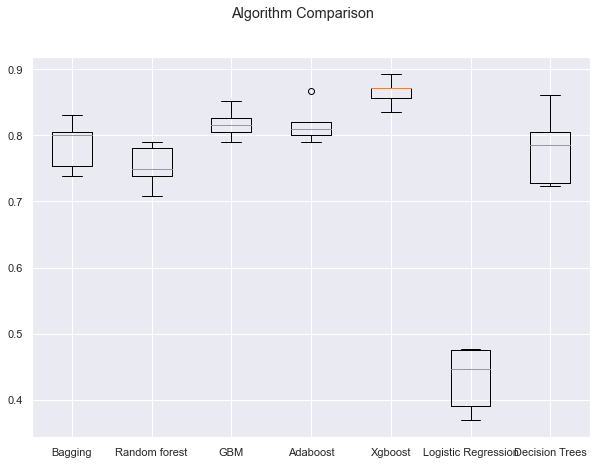

In [74]:
# Plotting boxplots for CV scores of all models defined above
fig = plt.figure(figsize=(10, 7))

fig.suptitle("Algorithm Comparison")
ax = fig.add_subplot(111)

plt.boxplot(results)
ax.set_xticklabels(names)

plt.show()

### Oversampling train data using SMOTE

In [75]:
print("Before Oversampling, counts of label 'Yes': {}".format(sum(y_train == 1)))
print("Before Oversampling, counts of label 'No': {} \n".format(sum(y_train == 0)))

sm = SMOTE(
    sampling_strategy=1, k_neighbors=5, random_state=1
)  # Synthetic Minority Over Sampling Technique
X_train_over, y_train_over = sm.fit_resample(X_train, y_train)


print("After Oversampling, counts of label 'Yes': {}".format(sum(y_train_over == 1)))
print("After Oversampling, counts of label 'No': {} \n".format(sum(y_train_over == 0)))


print("After Oversampling, the shape of train_X: {}".format(X_train_over.shape))
print("After Oversampling, the shape of train_y: {} \n".format(y_train_over.shape))

Before Oversampling, counts of label 'Yes': 976
Before Oversampling, counts of label 'No': 5099 

After Oversampling, counts of label 'Yes': 5099
After Oversampling, counts of label 'No': 5099 

After Oversampling, the shape of train_X: (10198, 29)
After Oversampling, the shape of train_y: (10198,) 



 ## Building the Over Sampled model

In [76]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("Bagging OS", BaggingClassifier(random_state=1)))
models.append(("Random forest OS", RandomForestClassifier(random_state=1)))
models.append(("GBM OS", GradientBoostingClassifier(random_state=1)))
models.append(("Adaboost OS", AdaBoostClassifier(random_state=1)))
models.append(("Xgboost OS", XGBClassifier(random_state=1, eval_metric="logloss")))
models.append(("Logistic Regression ", LogisticRegression(random_state=1)))
models.append(("Decision Trees", DecisionTreeClassifier(random_state=1)))

results = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Performance:" "\n")

for name, model in models:
    scoring = "recall"
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train_over, y=y_train_over, scoring=scoring, cv=kfold
    )
    results.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean() * 100))

print("\n" "Training Performance:" "\n")

for name, model in models:
    model.fit(X_train_over, y_train_over)
    scores = recall_score(y_train_over, model.predict(X_train_over)) * 100
    print("{}: {}".format(name, scores))


Cross-Validation Performance:

Bagging OS: 96.29346341087957
Random forest OS: 98.1564779002867
GBM OS: 97.01904981816082
Adaboost OS: 96.31305201177625
Xgboost OS: 98.47028035944506
Logistic Regression : 82.17337258750408
Decision Trees: 94.99921106813677

Training Performance:

Bagging OS: 99.78427142576976
Random forest OS: 100.0
GBM OS: 97.9603843890959
Adaboost OS: 96.56795450088252
Xgboost OS: 100.0
Logistic Regression : 82.44753873308493
Decision Trees: 100.0


    . XG Boost has highest value in over sampling  97.47004945255824

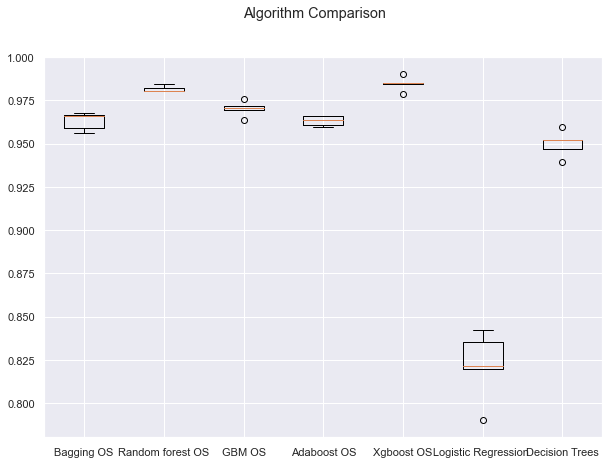

In [77]:
# Plotting boxplots for CV scores of all models defined above
fig = plt.figure(figsize=(10, 7))

fig.suptitle("Algorithm Comparison")
ax = fig.add_subplot(111)

plt.boxplot(results)
ax.set_xticklabels(names)

plt.show()

### Undersampling train data using Random Under Sampler

In [78]:
rus = RandomUnderSampler(random_state=1)
X_train_un, y_train_un = rus.fit_resample(X_train, y_train)

In [79]:
print("Before Undersampling, counts of label 'Yes': {}".format(sum(y_train == 1)))
print("Before Undersampling, counts of label 'No': {} \n".format(sum(y_train == 0)))

print("After Undersampling, counts of label 'Yes': {}".format(sum(y_train_un == 1)))
print("After Undersampling, counts of label 'No': {} \n".format(sum(y_train_un == 0)))

print("After Undersampling, the shape of train_X: {}".format(X_train_un.shape))
print("After Undersampling, the shape of train_y: {} \n".format(y_train_un.shape))

Before Undersampling, counts of label 'Yes': 976
Before Undersampling, counts of label 'No': 5099 

After Undersampling, counts of label 'Yes': 976
After Undersampling, counts of label 'No': 976 

After Undersampling, the shape of train_X: (1952, 29)
After Undersampling, the shape of train_y: (1952,) 



 ## Building the Under Sampled model

In [80]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("Bagging US", BaggingClassifier(random_state=1)))
models.append(("Random forest US", RandomForestClassifier(random_state=1)))
models.append(("GBM US", GradientBoostingClassifier(random_state=1)))
models.append(("Adaboost US", AdaBoostClassifier(random_state=1)))
models.append(("Xgboost US", XGBClassifier(random_state=1, eval_metric="logloss")))
models.append(("Logistic Regression US", LogisticRegression(random_state=1)))
models.append(("Decision Trees US", DecisionTreeClassifier(random_state=1)))

results = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Performance:" "\n")

for name, model in models:
    scoring = "recall"
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train_un, y=y_train_un, scoring=scoring, cv=kfold
    )
    results.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean() * 100))

print("\n" "Training Performance:" "\n")

for name, model in models:
    model.fit(X_train_un, y_train_un)
    scores = recall_score(y_train_un, model.predict(X_train_un)) * 100
    print("{}: {}".format(name, scores))
    
    
    

    


Cross-Validation Performance:

Bagging US: 91.29147043432756
Random forest US: 92.72736787022501
GBM US: 94.15960230245946
Adaboost US: 93.23966509680795
Xgboost US: 95.39037153322867
Logistic Regression US: 80.32653061224488
Decision Trees US: 88.83150183150181

Training Performance:

Bagging US: 98.97540983606558
Random forest US: 100.0
GBM US: 98.05327868852459
Adaboost US: 95.28688524590164
Xgboost US: 100.0
Logistic Regression US: 82.17213114754098
Decision Trees US: 100.0


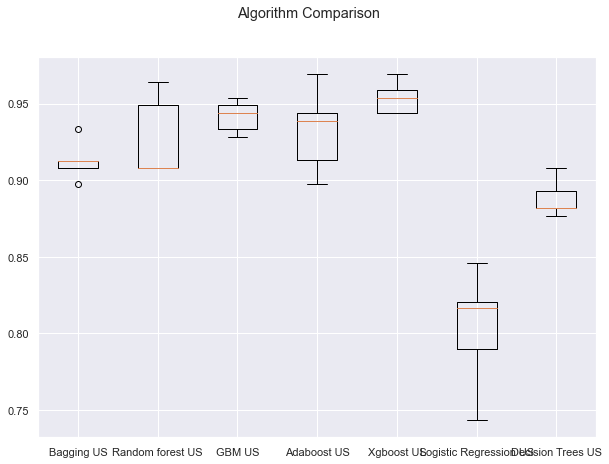

In [81]:
# Plotting boxplots for CV scores of all models defined above
fig = plt.figure(figsize=(10, 7))

fig.suptitle("Algorithm Comparison")
ax = fig.add_subplot(111)

plt.boxplot(results)
ax.set_xticklabels(names)

plt.show()

## Hyperparameter Tuning

**First, let's create two functions to calculate different metrics and confusion matrix so that we don't have to use the same code repeatedly for each model.**

In [82]:
# defining a function to compute different metrics to check performance of a classification model built using sklearn
def model_performance_classification_sklearn(model, predictors, target):
    """
    Function to compute different metrics to check classification model performance

    model: classifier
    predictors: independent variables
    target: dependent variable
    """

    # predicting using the independent variables
    pred = model.predict(predictors)

    acc = accuracy_score(target, pred)  # to compute Accuracy
    recall = recall_score(target, pred)  # to compute Recall
    precision = precision_score(target, pred)  # to compute Precision
    f1 = f1_score(target, pred)  # to compute F1-score

    # creating a dataframe of metrics
    df_perf = pd.DataFrame(
        {
            "Accuracy": acc,
            "Recall": recall,
            "Precision": precision,
            "F1": f1,
        },
        index=[0],
    )

    return df_perf

In [83]:
def confusion_matrix_sklearn(model, predictors, target):
    """
    To plot the confusion_matrix with percentages

    model: classifier
    predictors: independent variables
    target: dependent variable
    """
    y_pred = model.predict(predictors)
    cm = confusion_matrix(target, y_pred)
    labels = np.asarray(
        [
            ["{0:0.0f}".format(item) + "\n{0:.2%}".format(item / cm.flatten().sum())]
            for item in cm.flatten()
        ]
    ).reshape(2, 2)

    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=labels, fmt="")
    plt.ylabel("True label")
    plt.xlabel("Predicted label")

## Adaboost

### RandomizedSearchCV

In [84]:
%%time 

# defining model
model = AdaBoostClassifier(random_state=1)

# Parameter grid to pass in GridSearchCV

param_grid = {
    "n_estimators": np.arange(10, 110, 10),
    "learning_rate": [0.1, 0.01, 0.2, 0.05, 1],
    "base_estimator": [
        DecisionTreeClassifier(max_depth=1, random_state=1),
        DecisionTreeClassifier(max_depth=2, random_state=1),
        DecisionTreeClassifier(max_depth=3, random_state=1),
    ],
}

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=model, param_distributions=param_grid, n_jobs = -1, n_iter=50, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 100, 'learning_rate': 1, 'base_estimator': DecisionTreeClassifier(max_depth=2, random_state=1)} with CV score=0.8534432234432237:
CPU times: user 1.73 s, sys: 85.5 ms, total: 1.81 s
Wall time: 27.9 s


In [85]:
# building model with best parameters
adb_tuned2 = AdaBoostClassifier(
    n_estimators=20,
    learning_rate=1,
    random_state=1,
    base_estimator=DecisionTreeClassifier(max_depth=3, random_state=1),
)

# Fit the model on training data
adb_tuned2.fit(X_train, y_train)

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3,
                                                         random_state=1),
                   learning_rate=1, n_estimators=20, random_state=1)

In [86]:
# Calculating different metrics on train set
Adaboost_random_train = model_performance_classification_sklearn(
    adb_tuned2, X_train, y_train
)
print("Training performance:")
Adaboost_random_train

Training performance:


,Accuracy,Recall,Precision,F1
0,0.982,0.934,0.954,0.944


In [87]:
# Calculating different metrics on validation set
Adaboost_random_val = model_performance_classification_sklearn(adb_tuned2, X_val, y_val)
print("Validation performance:")
Adaboost_random_val

Validation performance:


,Accuracy,Recall,Precision,F1
0,0.959,0.847,0.893,0.869


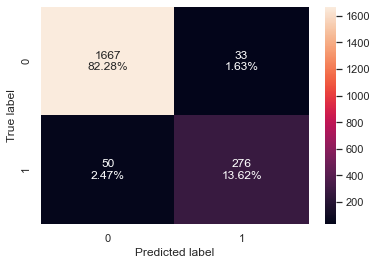

In [88]:
# creating confusion matrix
confusion_matrix_sklearn(adb_tuned2, X_val, y_val)

## XGBoost

### RandomizedSearchCV

In [89]:
%%time

# defining model
model = XGBClassifier(random_state=1,eval_metric='logloss')

# Parameter grid to pass in RandomizedSearchCV
param_grid={'n_estimators':np.arange(50,150,50),
            'scale_pos_weight':[2,5,10],
            'learning_rate':[0.01,0.1,0.2,0.05],
            'gamma':[0,1,3,5],
            'subsample':[0.8,0.9,1],
            'max_depth':np.arange(1,5,1),
            'reg_lambda':[5,10]}

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

#Calling RandomizedSearchCV
xgb_tuned2 = RandomizedSearchCV(estimator=model, param_distributions=param_grid, n_iter=50, scoring=scorer, cv=5, random_state=1, n_jobs = -1)

#Fitting parameters in RandomizedSearchCV
xgb_tuned2.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(xgb_tuned2.best_params_,xgb_tuned2.best_score_))




Best parameters are {'subsample': 0.8, 'scale_pos_weight': 10, 'reg_lambda': 10, 'n_estimators': 50, 'max_depth': 2, 'learning_rate': 0.1, 'gamma': 0} with CV score=0.9682260596546313:
CPU times: user 1.34 s, sys: 115 ms, total: 1.46 s
Wall time: 32.9 s


In [90]:
# building model with best parameters
xgb_tuned2 = XGBClassifier(
    random_state=1,
    n_estimators=50,
    scale_pos_weight=10,
    gamma=1,
    subsample=0.9,
    learning_rate=0.1,
    eval_metric="logloss",
    max_depth=1,
    reg_lambda=10,
)
# Fit the model on training data
xgb_tuned2.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric='logloss',
              gamma=1, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.1, max_delta_step=0,
              max_depth=1, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=50, n_jobs=8,
              num_parallel_tree=1, random_state=1, reg_alpha=0, reg_lambda=10,
              scale_pos_weight=10, subsample=0.9, tree_method='exact',
              validate_parameters=1, verbosity=None)

In [91]:
# Calculating different metrics on train set
xgboost_random_train = model_performance_classification_sklearn(
    xgb_tuned2, X_train, y_train
)
print("Training performance:")
xgboost_random_train

Training performance:


,Accuracy,Recall,Precision,F1
0,0.714,0.953,0.355,0.517


In [92]:
# Calculating different metrics on validation set
xgboost_random_val = model_performance_classification_sklearn(xgb_tuned2, X_val, y_val)
print("Validation performance:")
xgboost_random_val

Validation performance:


,Accuracy,Recall,Precision,F1
0,0.718,0.945,0.358,0.519


In [93]:
# Validation performance comparison

models_val_comp_df = pd.concat(
    [Adaboost_random_val.T, xgboost_random_val.T,],
    axis=1,
)
models_val_comp_df.columns = [
    "AdaBoost Tuned with Random search",
    "Xgboost Tuned with Random Search",
]
print("Validation performance comparison:")
models_val_comp_df

Validation performance comparison:


,AdaBoost Tuned with Random search,Xgboost Tuned with Random Search
Accuracy,0.959,0.718
Recall,0.847,0.945
Precision,0.893,0.358
F1,0.869,0.519


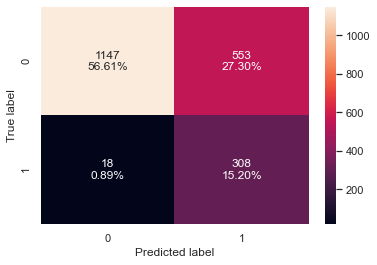

In [94]:
# creating confusion matrix
confusion_matrix_sklearn(xgb_tuned2, X_val, y_val)

### Gradient Boosting Classifier

### RandomizedSearchCV

Training performance 
    Accuracy  Recall  Precision    F1
0     1.000   1.000      1.000 1.000
Testing performance 
    Accuracy  Recall  Precision    F1
0     0.969   0.902      0.907 0.905
CPU times: user 22 s, sys: 248 ms, total: 22.3 s
Wall time: 1min 43s


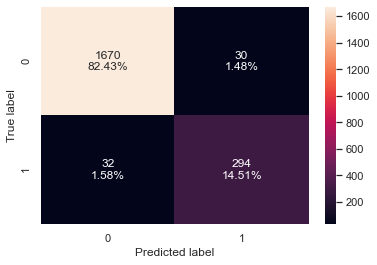

In [95]:
%%time
# Choose the type of classifier.
gbc_tuned = GradientBoostingClassifier(
    init=AdaBoostClassifier(random_state=1), random_state=1
)

# Grid of parameters to choose from
## add from article
parameters = {
    "n_estimators": [100, 150, 200, 250],
    "subsample": [0.8, 0.9, 1],
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=model, param_distributions=parameters, n_jobs = -1, scoring=acc_scorer, cv=10, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_over, y_train_over)

# Set the clf to the best combination of parameters
gbc_tuned = randomized_cv.best_estimator_

# Fit the best algorithm to the data.
gbc_tuned.fit(X_train_over, y_train_over)

# Calculating different metrics
gbc_tuned_model_train_perf = model_performance_classification_sklearn(
    gbc_tuned, X_train_over, y_train_over
)
print("Training performance \n", gbc_tuned_model_train_perf)

gbc_tuned_model_val_perf = model_performance_classification_sklearn(
    gbc_tuned, X_val, y_val
)
print("Testing performance \n", gbc_tuned_model_val_perf)

# Creating confusion matrix
confusion_matrix_sklearn(gbc_tuned, X_val, y_val)

In [96]:
%%time

# defining model
model = XGBClassifier(random_state=1,eval_metric='logloss')

# Parameter grid to pass in RandomizedSearchCV
param_grid={'n_estimators':np.arange(50,150,50),
            'scale_pos_weight':[2,5,10],
            'learning_rate':[0.01,0.1,0.2,0.05],
            'gamma':[0,1,3,5],
            'subsample':[0.8,0.9,1],
            'max_depth':np.arange(1,5,1),
            'reg_lambda':[5,10]}

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

#Calling RandomizedSearchCV
xgb_tuned2 = RandomizedSearchCV(estimator=model, param_distributions=param_grid, n_iter=50, scoring=scorer, cv=5, random_state=1, n_jobs = -1)

#Fitting parameters in RandomizedSearchCV
xgb_tuned2.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(xgb_tuned2.best_params_,xgb_tuned2.best_score_))

Best parameters are {'subsample': 0.8, 'scale_pos_weight': 10, 'reg_lambda': 10, 'n_estimators': 50, 'max_depth': 2, 'learning_rate': 0.1, 'gamma': 0} with CV score=0.9682260596546313:
CPU times: user 1.41 s, sys: 110 ms, total: 1.52 s
Wall time: 32.5 s


In [97]:
   # training performance comparison

models_train_comp_df = pd.concat(
    [
        Adaboost_random_train.T,
        xgboost_random_train.T,
    ],
    axis=1,
)
models_train_comp_df.columns = [
    "AdaBoost Tuned with Random search",
    "Xgboost Tuned with Random Search",
]
print("Training performance comparison:")
models_train_comp_df

Training performance comparison:


,AdaBoost Tuned with Random search,Xgboost Tuned with Random Search
Accuracy,0.982,0.714
Recall,0.934,0.953
Precision,0.954,0.355
F1,0.944,0.517


## Pipelines for productionizing the model
- Now, we have a final model. let's use pipelines to put the model into production



## Column Transformer
- We know that we can use pipelines to standardize the model building, but the steps in a pipeline are applied to each and every variable - how can we personalize the pipeline to perform different processing on different columns
- Column transformer allows different columns or column subsets of the input to be transformed separately and the features generated by each transformer will be concatenated to form a single feature space. This is useful for heterogeneous or columnar data, to combine several feature extraction mechanisms or transformations into a single transformer.

- We will create 2 different pipelines, one for numerical columns and one for categorical columns
- For numerical columns, we will do missing value imputation as pre-processing
- For categorical columns, we will do one hot encoding and missing value imputation as pre-processing

- We are doing missing value imputation for the whole data, so that if there is any missing value in the data in future that can be taken care of.

In [98]:
# creating a list of numerical variables
numerical_features = [
    "Customer_Age",
    "Total_Relationship_Count",
    "Months_Inactive_12_mon",
    "Contacts_Count_12_mon",
    "Credit_Limit",
    "Total_Revolving_Bal",
    "Avg_Open_To_Buy",
    "Total_Amt_Chng_Q4_Q1",
    "Total_Trans_Amt",
    "Dependent_count",
    "Avg_Utilization_Ratio",
    "Total_Ct_Chng_Q4_Q1",
    "Total_Trans_Ct",
    "Months_on_book",    
]

# creating a transformer for numerical variables, which will apply simple imputer on the numerical variables
numeric_transformer = Pipeline(steps=[("imputer", SimpleImputer(strategy="median"))])


# creating a list of categorical variables
categorical_features = ["Gender", "Education_Level", "Marital_Status", "Income_Category", "Card_Category"]

# creating a transformer for categorical variables, which will first apply simple imputer and 
#then do one hot encoding for categorical variables
categorical_transformer = Pipeline(
    steps=[
        ("imputer", SimpleImputer(strategy="most_frequent")),
        ("onehot", OneHotEncoder(handle_unknown="ignore")),
    ]
)
# handle_unknown = "ignore", allows model to handle any unknown category in the test data

# combining categorical transformer and numerical transformer using a column transformer

preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numerical_features),
        ("cat", categorical_transformer, categorical_features),
    ],
    remainder="passthrough",
)
# remainder = "passthrough" has been used, it will allow variables that are present in original data 
# but not in "numerical_columns" and "categorical_columns" to pass through the column transformer without any changes


In [99]:
# Separating target variable and other variables
X = data.drop(columns=["Attrition_Flag"])
Y = data["Attrition_Flag"]

- Now we already know the best model we need to process with, so we don't need to divide data into 3 parts

In [100]:
# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    X, Y, test_size=0.30, random_state=1, stratify=Y
)
print(X_train.shape, X_test.shape)

(7088, 19) (3039, 19)


In [101]:
# Creating new pipeline with best parameters
model = Pipeline(
    steps=[
        ("pre", preprocessor),
        (
            "XGB",
            XGBClassifier(
                random_state=1,
                n_estimators=50,
                scale_pos_weight=10,
                subsample=1,
                learning_rate=0.05,
                gamma=0,
                eval_metric="logloss",
                reg_lambda=10,
                max_depth=1,
            ),
        ),
    ]
)
# Fit the model on training data
model.fit(X_train, y_train)

Pipeline(steps=[('pre',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['Customer_Age',
                                                   'Total_Relationship_Count',
                                                   'Months_Inactive_12_mon',
                                                   'Contacts_Count_12_mon',
                                                   'Credit_Limit',
                                                   'Total_Revolving_Bal',
                                                   'Avg_Open_To_Buy',
                                                   'Total_Amt_Chng_Q4_Q1',
                                                   'Total_Trans_Amt',
                      

In [102]:
# transforming and predicting on test data
model.predict(X_test)

array([0, 1, 0, ..., 0, 0, 0])

### Recomendations

  1. Increase number of proeudcts with higher income for more useage
  2. Put an alert on not usage from customer care to follow up for economic hardships and competros taking business
  3. Banks should target cusomers who has more dependends
  4. if usage is going down per quarter, follow up and see what is going on, as it  is not captured here.
  